## Importing the Libraries

In [17]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

## Importing the Dataset

In [18]:
df=pd.read_csv(r"C:\Users\priya\OneDrive\Desktop\Priya\weather.csv")
df.head()

,Unnamed: 0,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
0,0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,...,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No
1,1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,...,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No
2,2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,...,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No
3,3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,...,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No
4,4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,...,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No


## Exploratort Data Analysis (EDA)

In [19]:
print('Number of Rows',df.shape[0])
print('Number of Columns',df.shape[1])

Number of Rows 25000
Number of Columns 25


In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 25 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Unnamed: 0     25000 non-null  int64  
 1   Date           25000 non-null  object 
 2   Location       25000 non-null  object 
 3   MinTemp        24669 non-null  float64
 4   MaxTemp        24824 non-null  float64
 5   Rainfall       24721 non-null  float64
 6   Evaporation    9432 non-null   float64
 7   Sunshine       6664 non-null   float64
 8   WindGustDir    21543 non-null  object 
 9   WindGustSpeed  21545 non-null  float64
 10  WindDir9am     21928 non-null  object 
 11  WindDir3pm     23267 non-null  object 
 12  WindSpeed9am   24428 non-null  float64
 13  WindSpeed3pm   23770 non-null  float64
 14  Humidity9am    24609 non-null  float64
 15  Humidity3pm    23936 non-null  float64
 16  Pressure9am    20172 non-null  float64
 17  Pressure3pm    20173 non-null  float64
 18  Cloud9

### The Above datset consist 25000 Rows and 25 Columns and there is some null values in the dataset. Know what we are going to do is if the null values in our dataset is less than equal to 3% then we are going to drop those null record or if the null values is greater then 3% but less then 50% in that case we are going to fill that null values by there mean and if it is greater 50% that case we are droping the columns.

In [21]:
df.isnull().sum()

Unnamed: 0           0
Date                 0
Location             0
MinTemp            331
MaxTemp            176
Rainfall           279
Evaporation      15568
Sunshine         18336
WindGustDir       3457
WindGustSpeed     3455
WindDir9am        3072
WindDir3pm        1733
WindSpeed9am       572
WindSpeed3pm      1230
Humidity9am        391
Humidity3pm       1064
Pressure9am       4828
Pressure3pm       4827
Cloud9am         10864
Cloud3pm         11185
Temp9am            245
Temp3pm            918
RainToday          279
RISK_MM              0
RainTomorrow         0
dtype: int64

### Calculating the percentage of null values

In [22]:
df.isnull().sum()/len(df)*100

Unnamed: 0        0.000
Date              0.000
Location          0.000
MinTemp           1.324
MaxTemp           0.704
Rainfall          1.116
Evaporation      62.272
Sunshine         73.344
WindGustDir      13.828
WindGustSpeed    13.820
WindDir9am       12.288
WindDir3pm        6.932
WindSpeed9am      2.288
WindSpeed3pm      4.920
Humidity9am       1.564
Humidity3pm       4.256
Pressure9am      19.312
Pressure3pm      19.308
Cloud9am         43.456
Cloud3pm         44.740
Temp9am           0.980
Temp3pm           3.672
RainToday         1.116
RISK_MM           0.000
RainTomorrow      0.000
dtype: float64

In [23]:
df.duplicated().sum() #there is no duplicated values are present.

0

In [24]:
df.describe()

,Unnamed: 0,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM
count,25000.000000,24669.000000,24824.000000,24721.000000,9432.000000,6664.000000,21545.000000,24428.000000,23770.000000,24609.000000,23936.000000,20172.000000,20173.000000,14136.000000,13815.000000,24755.000000,24082.000000,25000.000000
mean,12499.500000,13.294568,23.990558,2.674467,5.825138,7.811945,37.772755,12.686917,16.837106,69.822951,52.762826,1018.173290,1015.627438,4.251556,4.409265,17.953084,22.507171,2.677376
std,7217.022701,5.848304,6.114348,9.720306,4.871567,3.718698,13.212331,9.136115,9.095719,17.755908,21.210121,6.481112,6.394829,2.968785,2.719235,5.394685,5.954540,9.705604
min,0.000000,-3.300000,6.800000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,3.000000,1.000000,980.500000,979.000000,0.000000,0.000000,0.300000,6.400000,0.000000
25%,6249.750000,8.900000,19.500000,0.000000,3.000000,5.500000,28.000000,6.000000,9.000000,58.000000,37.000000,1013.800000,1011.300000,1.000000,2.000000,14.200000,18.100000,0.000000
50%,12499.500000,14.000000,23.400000,0.000000,4.800000,8.900000,35.000000,11.000000,17.000000,71.000000,54.000000,1018.200000,1015.700000,5.000000,5.000000,18.400000,21.900000,0.000000
75%,18749.250000,17.900000,27.700000,0.600000,7.200000,10.600000,46.000000,19.000000,22.000000,83.000000,68.000000,1022.600000,1020.000000,7.000000,7.000000,21.900000,26.100000,0.800000
max,24999.000000,29.700000,47.300000,371.000000,86.200000,14.000000,135.000000,130.000000,83.000000,100.000000,100.000000,1039.900000,1036.800000,8.000000,8.000000,37.700000,46.700000,371.000000


### In the above Dataset it gives the statistical value of the columns. Mean and Median value of every column. After looking upon the values of the columns there is no far difference in the mean and median. we can say mean = median hence the data is called as Normal Distribution which has zero(0) skewness

### Droping unwanted columns or droping those column whose null values is more than 50%

In [25]:
df.drop('Unnamed: 0',axis=1,inplace=True) 

In [26]:
df.drop(['Evaporation','Sunshine'],axis=1,inplace=True)

In [27]:
df['Temp9am'].isnull().sum()/sum(df['Temp9am'])*100

nan

In [28]:
df.isnull().sum()/len(df)*100

Date              0.000
Location          0.000
MinTemp           1.324
MaxTemp           0.704
Rainfall          1.116
WindGustDir      13.828
WindGustSpeed    13.820
WindDir9am       12.288
WindDir3pm        6.932
WindSpeed9am      2.288
WindSpeed3pm      4.920
Humidity9am       1.564
Humidity3pm       4.256
Pressure9am      19.312
Pressure3pm      19.308
Cloud9am         43.456
Cloud3pm         44.740
Temp9am           0.980
Temp3pm           3.672
RainToday         1.116
RISK_MM           0.000
RainTomorrow      0.000
dtype: float64

In [29]:
df.drop(['Location','WindDir9am','WindDir3pm','RainToday','WindGustDir'],axis=1,inplace=True)

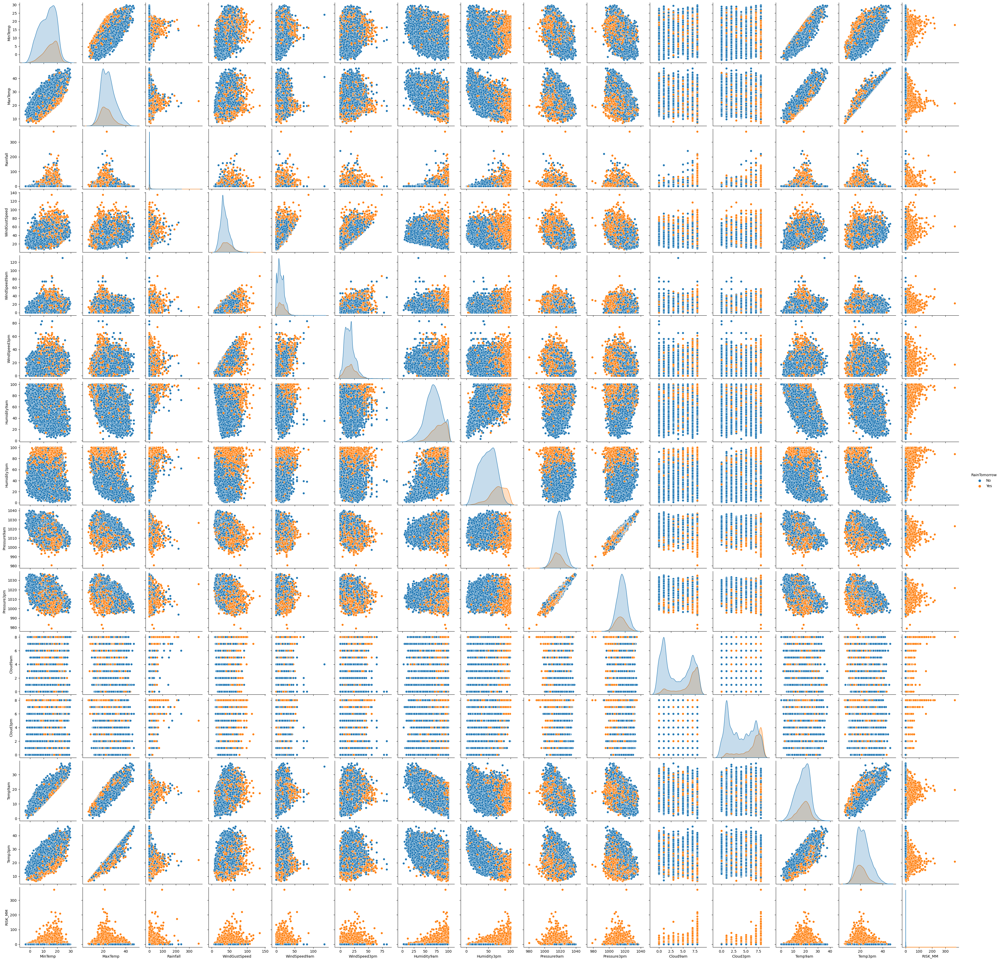

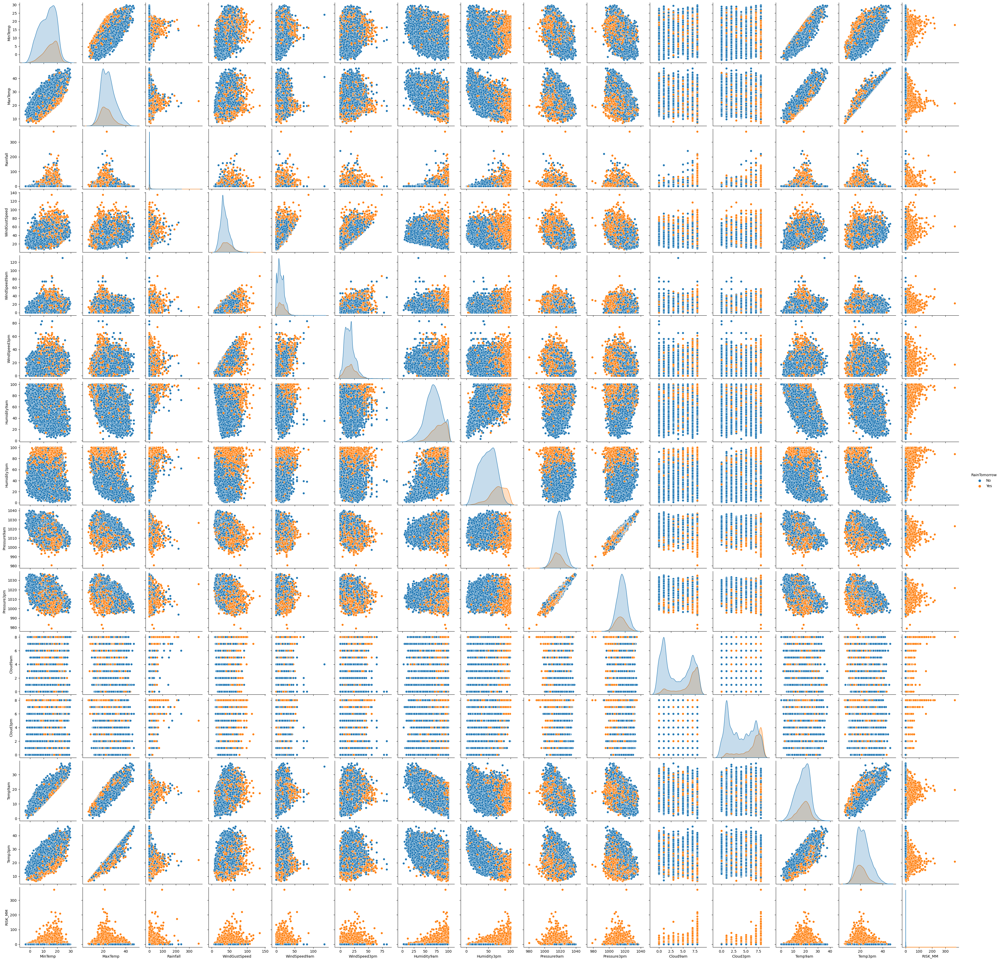

In [32]:
sns.pairplot(data=df,hue='RainTomorrow')
plt.show()

In [31]:
df.head()

,Date,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM,RainTomorrow
0,2008-12-01,13.4,22.9,0.6,44.0,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,0.0,No
1,2008-12-02,7.4,25.1,0.0,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,0.0,No
2,2008-12-03,12.9,25.7,0.0,46.0,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,0.0,No
3,2008-12-04,9.2,28.0,0.0,24.0,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,1.0,No
4,2008-12-05,17.5,32.3,1.0,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0.2,No


### Spliting Features(x) and Target (y)

In [33]:
x=df.iloc[:,1:-1]
y=df.iloc[:,-1]

### using SimpleImputer to fill null values with there mean

In [34]:
from sklearn.impute import SimpleImputer
si=SimpleImputer()
x[['Pressure9am','Pressure3pm','Cloud9am','Cloud3pm',
   "WindGustSpeed"]]=si.fit_transform(x[['Pressure9am','Pressure3pm','Cloud9am','Cloud3pm',"WindGustSpeed"]])

In [35]:
x.isnull().sum()/len(x)*100

MinTemp          1.324
MaxTemp          0.704
Rainfall         1.116
WindGustSpeed    0.000
WindSpeed9am     2.288
WindSpeed3pm     4.920
Humidity9am      1.564
Humidity3pm      4.256
Pressure9am      0.000
Pressure3pm      0.000
Cloud9am         0.000
Cloud3pm         0.000
Temp9am          0.980
Temp3pm          3.672
RISK_MM          0.000
dtype: float64

In [36]:
i=x[x.MinTemp.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.MaxTemp.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.Rainfall.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.WindSpeed9am.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.WindSpeed3pm.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.Humidity3pm.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.Humidity9am.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.MaxTemp.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.Temp3pm.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)
i=x[x.Temp9am.isnull()].index
x.drop(i,inplace=True)
y.drop(i,inplace=True)

### So we have done use SimpleImputer to fill tha null values with mean and drop then unwanted columns and columns which having null values more than 50% and Now our data is ready to apply algorithms.

In [37]:
y.isnull().sum()/len(df)*100

0.0

In [38]:
x.isnull().sum()/len(x)*100

MinTemp          0.0
MaxTemp          0.0
Rainfall         0.0
WindGustSpeed    0.0
WindSpeed9am     0.0
WindSpeed3pm     0.0
Humidity9am      0.0
Humidity3pm      0.0
Pressure9am      0.0
Pressure3pm      0.0
Cloud9am         0.0
Cloud3pm         0.0
Temp9am          0.0
Temp3pm          0.0
RISK_MM          0.0
dtype: float64

In [39]:
x.corr().style.background_gradient()

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM
MinTemp,1.000000,0.667118,0.107353,0.345714,0.310912,0.238169,-0.109578,0.166360,-0.431910,-0.400840,0.118061,0.128009,0.895467,0.632761,0.121062
MaxTemp,0.667118,1.000000,-0.087864,0.179263,0.048650,0.036384,-0.405749,-0.451552,-0.352156,-0.414700,-0.189449,-0.125181,0.837529,0.981101,-0.074701
Rainfall,0.107353,-0.087864,1.000000,0.154241,0.125425,0.075215,0.242526,0.258591,-0.121388,-0.085861,0.180017,0.137624,0.005710,-0.089966,0.288954
WindGustSpeed,0.345714,0.179263,0.154241,1.000000,0.516061,0.621320,-0.182365,0.048327,-0.400370,-0.371637,0.042213,0.074662,0.316803,0.137246,0.195546
WindSpeed9am,0.310912,0.048650,0.125425,0.516061,1.000000,0.500074,-0.273004,0.037584,-0.157385,-0.111333,0.001743,0.048285,0.253654,0.038128,0.103674
WindSpeed3pm,0.238169,0.036384,0.075215,0.621320,0.500074,1.000000,-0.134026,0.102107,-0.227908,-0.187623,0.022604,0.006224,0.220783,0.008001,0.072921
Humidity9am,-0.109578,-0.405749,0.242526,-0.182365,-0.273004,-0.134026,1.000000,0.655567,0.106093,0.131636,0.395986,0.281919,-0.372858,-0.402491,0.194161
Humidity3pm,0.166360,-0.451552,0.258591,0.048327,0.037584,0.102107,0.655567,1.000000,0.009415,0.079083,0.406921,0.394357,-0.086341,-0.510262,0.326021
Pressure9am,-0.431910,-0.352156,-0.121388,-0.400370,-0.157385,-0.227908,0.106093,0.009415,1.000000,0.965916,-0.068931,-0.093241,-0.419537,-0.319115,-0.086512
Pressure3pm,-0.400840,-0.414700,-0.085861,-0.371637,-0.111333,-0.187623,0.131636,0.079083,0.965916,1.000000,-0.037970,-0.070207,-0.424475,-0.386642,-0.077901


In [40]:
x

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM
0,13.4,22.9,0.6,44.0,20.0,24.0,71.0,22.0,1007.70000,1007.100000,8.000000,4.409265,16.9,21.8,0.0
1,7.4,25.1,0.0,44.0,4.0,22.0,44.0,25.0,1010.60000,1007.800000,4.251556,4.409265,17.2,24.3,0.0
2,12.9,25.7,0.0,46.0,19.0,26.0,38.0,30.0,1007.60000,1008.700000,4.251556,2.000000,21.0,23.2,0.0
3,9.2,28.0,0.0,24.0,11.0,9.0,45.0,16.0,1017.60000,1012.800000,4.251556,4.409265,18.1,26.5,1.0
4,17.5,32.3,1.0,41.0,7.0,20.0,82.0,33.0,1010.80000,1006.000000,7.000000,8.000000,17.8,29.7,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24995,16.5,30.0,0.0,26.0,2.0,7.0,87.0,41.0,1018.17329,1015.627438,4.251556,4.409265,21.6,29.4,0.0
24996,16.7,30.5,0.0,24.0,4.0,6.0,84.0,44.0,1018.17329,1015.627438,4.251556,4.409265,21.3,29.0,0.0
24997,18.3,29.8,0.0,26.0,0.0,6.0,98.0,49.0,1018.17329,1015.627438,4.251556,4.409265,20.6,28.2,0.0
24998,17.5,28.1,0.0,22.0,4.0,7.0,90.0,54.0,1018.17329,1015.627438,4.251556,4.409265,21.2,26.8,0.0


## Spliting features(x) and target(y) for training and testing

In [41]:
from sklearn.model_selection import train_test_split
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.20,random_state=1)


## KNN Algorithm

In [42]:
from sklearn.neighbors import KNeighborsClassifier 
knn=KNeighborsClassifier()
knn.fit(xtrain,ytrain)
ypred=knn.predict(xtest)

In [25]:
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
ac=accuracy_score(ytest,ypred)
print(ac)

0.8890810810810811


In [26]:
test=knn.score(xtest,ytest)
train=knn.score(xtrain,ytrain)
print(test,train)

0.8890810810810811 0.9117154133102665


## KNN HyperTunning to get better accuracy

In [27]:
ac_list=[]
for i in range(1,31):
    knn=KNeighborsClassifier(n_neighbors=i)
    knn.fit(xtrain,ytrain)
    ypred=knn.predict(xtest)
    
    ac=accuracy_score(ytest,ypred)
    ac_list.append(ac)

In [28]:
ac_list

[0.8627027027027027,
 0.8808648648648648,
 0.8821621621621621,
 0.8847567567567568,
 0.8890810810810811,
 0.8858378378378379,
 0.8890810810810811,
 0.8867027027027027,
 0.8882162162162163,
 0.8875675675675676,
 0.8895135135135135,
 0.8864864864864865,
 0.8888648648648648,
 0.8864864864864865,
 0.8871351351351351,
 0.8856216216216216,
 0.888,
 0.8858378378378379,
 0.8873513513513513,
 0.884972972972973,
 0.8892972972972973,
 0.8856216216216216,
 0.8886486486486487,
 0.8867027027027027,
 0.8899459459459459,
 0.8864864864864865,
 0.8877837837837838,
 0.8867027027027027,
 0.8873513513513513,
 0.8862702702702703]

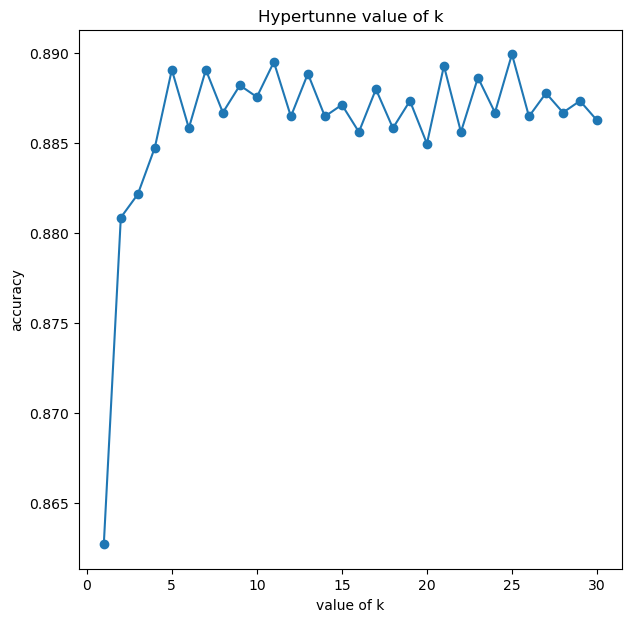

In [29]:
plt.figure(figsize=(7,7))
plt.plot(range(1,31),ac_list,marker='o')
plt.title('Hypertunne value of k')
plt.xlabel('value of k')
plt.ylabel('accuracy')
plt.show()

In [30]:
knn=KNeighborsClassifier(n_neighbors=25)
knn.fit(xtrain,ytrain)
ypred=knn.predict(xtest)

ac=accuracy_score(ytest,ypred)
ac

0.8899459459459459

In [31]:
confusion_matrix(ytest,ypred)

array([[3545,   53],
       [ 456,  571]], dtype=int64)

In [32]:
cr=classification_report(ytest,ypred)
print(cr)

              precision    recall  f1-score   support

          No       0.89      0.99      0.93      3598
         Yes       0.92      0.56      0.69      1027

    accuracy                           0.89      4625
   macro avg       0.90      0.77      0.81      4625
weighted avg       0.89      0.89      0.88      4625



### KNN algorithm is giving me the accuracy or 89%

In [33]:
x.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'WindGustSpeed', 'WindSpeed9am',
       'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am',
       'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RISK_MM'],
      dtype='object')

## Doing Prediction on new values

In [ ]:
def predict():
    MinTemp=float(input('Enter the MinTemp: '))
    MaxTemp=float(input('Enter the MaxTemp: '))    
    Rainfall=float(input('Enter the Rainfall: '))    
    WindGustSpeed=float(input('Enter the WindGustSpeed: '))    
    WindSpeed9am=float(input('Enter the WindSpeed9am: '))    
    WindSpeed3pm=float(input('Enter the WindSpeed3pm: '))    
    Humidity9am=float(input('Enter the Humidity9am: '))    
    Humidity3pm=float(input('Enter the Humidity3pm: '))    
    Pressure9am=float(input('Enter the Pressure9am: '))  
    Pressure3pm=float(input('Enter the Pressure3pm: '))       
    Cloud9am=float(input('Enter the Cloud9am: '))       
    Cloud3pm=float(input('Enter the Cloud3pm: '))       
    Temp9am=float(input('Enter the Temp9am: '))       
    Temp3pm=float(input('Enter the Temp3pm: '))       
    RISK_MM=float(input('Enter the RISK_MM: '))
    
    newobs=[[MinTemp, MaxTemp, Rainfall, WindGustSpeed, WindSpeed9am,
       WindSpeed3pm, Humidity9am, Humidity3pm, Pressure9am,
       Pressure3pm, Cloud9am, Cloud3pm, Temp9am, Temp3pm, RISK_MM]]
    
    return knn.predict(newobs)[0]
    

In [ ]:
x.head()

In [ ]:
predict()

## Logistic Regression

In [34]:
from sklearn.linear_model import LogisticRegression
logreg=LogisticRegression()
logreg.fit(xtrain,ytrain)
ypred=logreg.predict(xtest)

In [35]:
ac=accuracy_score(ytest,ypred)
cr=classification_report(ytest,ypred)
print(ac)
print(cr)

0.9898378378378379
              precision    recall  f1-score   support

          No       0.99      0.99      0.99      3598
         Yes       0.97      0.98      0.98      1027

    accuracy                           0.99      4625
   macro avg       0.98      0.99      0.99      4625
weighted avg       0.99      0.99      0.99      4625



In [36]:
test=logreg.score(xtest,ytest)
train=logreg.score(xtrain,ytrain)
print(test,train)

0.9898378378378379 0.991295885819322


### After applying Logestic Regression here I'm getting accuracy of 99%

## SVM

In [37]:
from sklearn.svm import SVC
svm=SVC()
svm.fit(xtrain,ytrain)
ypred=svm.predict(xtest)

In [38]:
print(accuracy_score(ytest,ypred))
print(classification_report(ytest,ypred))

0.8181621621621622
              precision    recall  f1-score   support

          No       0.81      1.00      0.90      3598
         Yes       0.99      0.18      0.31      1027

    accuracy                           0.82      4625
   macro avg       0.90      0.59      0.60      4625
weighted avg       0.85      0.82      0.76      4625



In [39]:
test=svm.score(xtest,ytest)
train=svm.score(xtrain,ytrain)
print(test,train)

0.8181621621621622 0.8182407958047251


### SVM is giving me the accuracy of 82%

### Hypertunning on svm

In [40]:
svm1=SVC(kernel='linear')

In [41]:
svm.fit(xtrain,ytrain)
ypred=svm.predict(xtest)

print(accuracy_score(ytest,ypred))
print(classification_report(ytest,ypred))

0.8181621621621622
              precision    recall  f1-score   support

          No       0.81      1.00      0.90      3598
         Yes       0.99      0.18      0.31      1027

    accuracy                           0.82      4625
   macro avg       0.90      0.59      0.60      4625
weighted avg       0.85      0.82      0.76      4625



In [42]:
test=svm.score(xtest,ytest)
train=svm.score(xtrain,ytrain)
print(test,train)

0.8181621621621622 0.8182407958047251


### After applying svm hupertunner kernel=linear i get tesing and training score 81% 

In [43]:
svm=SVC(kernel='poly')
svm.fit(xtrain,ytrain)
ypred=svm.predict(xtest)

print(accuracy_score(ytest,ypred))
print(classification_report(ytest,ypred))

0.8412972972972973
              precision    recall  f1-score   support

          No       0.83      1.00      0.91      3598
         Yes       1.00      0.29      0.44      1027

    accuracy                           0.84      4625
   macro avg       0.91      0.64      0.68      4625
weighted avg       0.87      0.84      0.80      4625



In [44]:
test=svm.score(xtest,ytest)
train=svm.score(xtrain,ytrain)
print(test,train)

0.8412972972972973 0.8401362383089149


### After applying svm hupertunner kernel=poly i get tesing and training score 84% 

In [45]:
svm=SVC(kernel='sigmoid')
svm.fit(xtrain,ytrain)
ypred=svm.predict(xtest)

print(accuracy_score(ytest,ypred))
print(classification_report(ytest,ypred))

0.7783783783783784
              precision    recall  f1-score   support

          No       0.78      1.00      0.88      3598
         Yes       1.00      0.00      0.00      1027

    accuracy                           0.78      4625
   macro avg       0.89      0.50      0.44      4625
weighted avg       0.83      0.78      0.68      4625



In [46]:
test=svm.score(xtest,ytest)
train=svm.score(xtrain,ytrain)
print(test,train)

0.7783783783783784 0.7807211980321133


### but after applying svm hupertunner kernel=sigmoid my tesing and training score reduce to 78%

## Decision tree

In [47]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

In [48]:
dt=DecisionTreeClassifier()
dt.fit(xtrain,ytrain)
ypred=dt.predict(xtest)

In [64]:
print(classification_report(ytest,ypred))
print(dt.score(xtrain,ytrain))
print(dt.score(xtest,ytest))

              precision    recall  f1-score   support

          No       1.00      1.00      1.00      3598
         Yes       1.00      1.00      1.00      1027

    accuracy                           1.00      4625
   macro avg       1.00      1.00      1.00      4625
weighted avg       1.00      1.00      1.00      4625

1.0
1.0


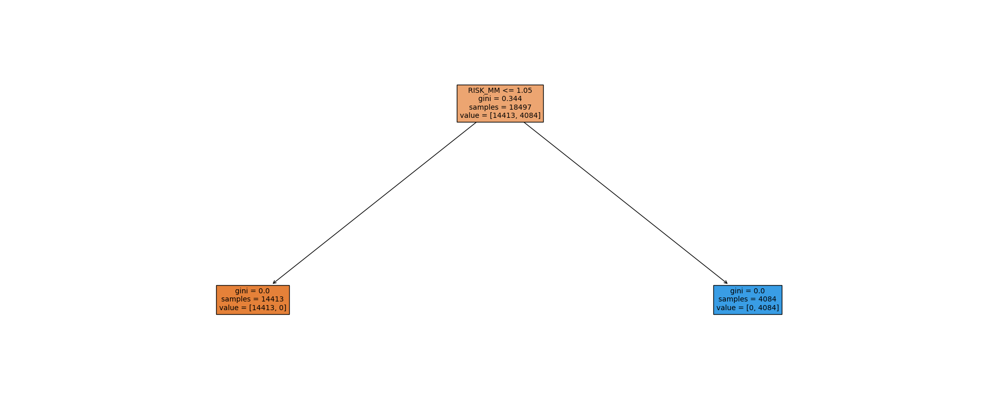

In [50]:
fig,ax=plt.subplots(figsize=(25,10))
chart=tree.plot_tree(dt,max_depth=5,feature_names=x.columns,filled=True,fontsize=10)
plt.savefig("weather.jpg")

In [51]:
train=dt.score(xtrain,ytrain)
test=dt.score(xtest,ytest)
print(f"train score: {train}\n test score: {test}")

train score: 1.0
 test score: 1.0


### Decision Tree model are overfitting

## Ensemble Learning

### Bagging

In [52]:
from sklearn.ensemble import BaggingClassifier
bg=BaggingClassifier(LogisticRegression())
bg.fit(xtrain,ytrain)
ypred=bg.predict(xtest)
print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

          No       0.99      0.99      0.99      3598
         Yes       0.97      0.98      0.98      1027

    accuracy                           0.99      4625
   macro avg       0.98      0.99      0.98      4625
weighted avg       0.99      0.99      0.99      4625



In [53]:
train=bg.score(xtrain,ytrain)
test=bg.score(xtest,ytest)

In [54]:
print(train,test)

0.991187760177326 0.9891891891891892


In [55]:
from sklearn.ensemble import BaggingClassifier
bg=BaggingClassifier(DecisionTreeClassifier())
bg.fit(xtrain,ytrain)
ypred=bg.predict(xtest)
print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

          No       1.00      1.00      1.00      3598
         Yes       1.00      1.00      1.00      1027

    accuracy                           1.00      4625
   macro avg       1.00      1.00      1.00      4625
weighted avg       1.00      1.00      1.00      4625



In [56]:
from sklearn.ensemble import BaggingClassifier
bg=BaggingClassifier(SVC())
bg.fit(xtrain,ytrain)
ypred=bg.predict(xtest)
print(classification_report(ytest,ypred))
train=bg.score(xtrain,ytrain)
test=bg.score(xtest,ytest)
print(train,test)

              precision    recall  f1-score   support

          No       0.81      1.00      0.90      3598
         Yes       0.99      0.18      0.31      1027

    accuracy                           0.82      4625
   macro avg       0.90      0.59      0.60      4625
weighted avg       0.85      0.82      0.77      4625

0.8181867329837271 0.8183783783783783


In [57]:
from sklearn.ensemble import BaggingClassifier
bg=BaggingClassifier(KNeighborsClassifier())
bg.fit(xtrain,ytrain)
ypred=bg.predict(xtest)
print(classification_report(ytest,ypred))
train=bg.score(xtrain,ytrain)
test=bg.score(xtest,ytest)
print(train,test)

              precision    recall  f1-score   support

          No       0.89      0.97      0.93      3598
         Yes       0.86      0.60      0.71      1027

    accuracy                           0.89      4625
   macro avg       0.88      0.78      0.82      4625
weighted avg       0.89      0.89      0.88      4625

0.9142023030761746 0.8892972972972973


In [58]:
model=[]
accuracy=[]
model.append(("lr",LogisticRegression()))
model.append(("dt",SVC()))
model.append(('knn',KNeighborsClassifier()))

In [59]:
from sklearn.ensemble import VotingClassifier
vc=VotingClassifier(estimators=model)
vc.fit(xtrain,ytrain)
ypred=vc.predict(xtest)
print(classification_report(ytest,ypred))
train=bg.score(xtrain,ytrain)
test=bg.score(xtest,ytest)
print(train,test)

              precision    recall  f1-score   support

          No       0.90      1.00      0.95      3598
         Yes       0.99      0.60      0.75      1027

    accuracy                           0.91      4625
   macro avg       0.94      0.80      0.85      4625
weighted avg       0.92      0.91      0.90      4625

0.9142023030761746 0.8892972972972973


### Boosting

### 1.AdaBoostClassifier

In [60]:
from sklearn.ensemble import AdaBoostClassifier
ab=AdaBoostClassifier()
ab.fit(xtrain,ytrain)
ypred=ab.predict(xtest)
print(classification_report(ytest,ypred))
train=bg.score(xtrain,ytrain)
test=bg.score(xtest,ytest)
print(train,test)

              precision    recall  f1-score   support

          No       1.00      1.00      1.00      3598
         Yes       1.00      1.00      1.00      1027

    accuracy                           1.00      4625
   macro avg       1.00      1.00      1.00      4625
weighted avg       1.00      1.00      1.00      4625

0.9142023030761746 0.8892972972972973


### 2.GradientBoosting

In [64]:
from sklearn.ensemble import GradientBoostingClassifier
gb=GradientBoostingClassifier()
gb.fit(xtrain,ytrain)
ypred=gb.predict(xtest)
print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

          No       1.00      1.00      1.00      3598
         Yes       1.00      1.00      1.00      1027

    accuracy                           1.00      4625
   macro avg       1.00      1.00      1.00      4625
weighted avg       1.00      1.00      1.00      4625



### Conclusion:
    i have applied many algorithms like KNN,svm,logestic regression,Decision tree, ensamble learning
    and every model was given a acuuracy but Logistic Regression is giving me the accuracy or 99% wich is higest among all the algoriths
    therefore for my model *logestic regression* is best fit model